In [22]:

import cv2
import numpy as np
import scipy
import pickle
import random
import os
import matplotlib.pyplot as plt

In [23]:
from notebooks.utils import display_image_in_actual_size

def extract_features(image, vector_size=32):
    
    try:
        # Using KAZE, cause SIFT, ORB and other was moved to additional module
        # which is adding addtional pain during install
        alg = cv2.KAZE_create()
        # Dinding image keypoints
        kps = alg.detect(image)
        # Getting first 32 of them. 
        # Number of keypoints is varies depend on image size and color pallet
        # Sorting them based on keypoint response value(bigger is better)
        kps = sorted(kps, key=lambda x: -x.response)[:vector_size]
        # computing descriptors vector
        kps, dsc = alg.compute(image, kps)
        # Flatten all of them in one big vector - our feature vector
        dsc = dsc.flatten()
        # Making descriptor of same size
        # Descriptor vector size is 64
        needed_size = (vector_size * 64)
        if dsc.size < needed_size:
            # if we have less the 32 descriptors then just adding zeros at the
            # end of our feature vector
            dsc = np.concatenate([dsc, np.zeros(needed_size - dsc.size)])
    except cv2.error as e:
        print('Error: ', e)
        return None

    return dsc


def batch_extractor(images_path, pickled_db_path="features.pck"):
    files = [os.path.join(images_path, p) for p in sorted(os.listdir(images_path))]

    result = {}
    for f in files:
        print('Extracting features from image %s' % f)
        name = f.split('/')[-1].lower()
        img = cv2.imread(f, cv2.IMREAD_GRAYSCALE)    
        result[name] = extract_features(img)
    
    # saving all our feature vectors in pickled file
    with open(pickled_db_path, 'bw') as fp:
        pickle.dump(result, fp)

In [26]:
import scipy.spatial.distance

class Matcher(object):

    def __init__(self, pickled_db_path="features.pck"):
        with open(pickled_db_path, 'rb') as fp:
            self.data = pickle.load(fp)
        self.names = []
        self.matrix = []
        for k, v in self.data.items():
            self.names.append(k)
            self.matrix.append(v)
        self.matrix = np.array(self.matrix)
        self.names = np.array(self.names)

    def cos_cdist(self, vector):
        # getting cosine distance between search image and images database
        v = vector.reshape(1, -1)
        return scipy.spatial.distance.cdist(self.matrix, v, 'cosine').reshape(-1)

    def match(self, image_path, topn=5):
        print(image_path)
        img = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
        features = extract_features(img)
        img_distances = self.cos_cdist(features)
        # getting top 5 records
        nearest_ids = np.argsort(img_distances)[:topn].tolist()
        nearest_img_paths = self.names[nearest_ids].tolist()

        return nearest_img_paths, img_distances[nearest_ids].tolist()

Query image ==========================================
../images/surname_tables/inangel2.png
Result images ========================================
Match 1.0
Match 0.7937647298119771
Match 0.7898119731759039
Query image ==========================================
../images/surname_tables/test2.png


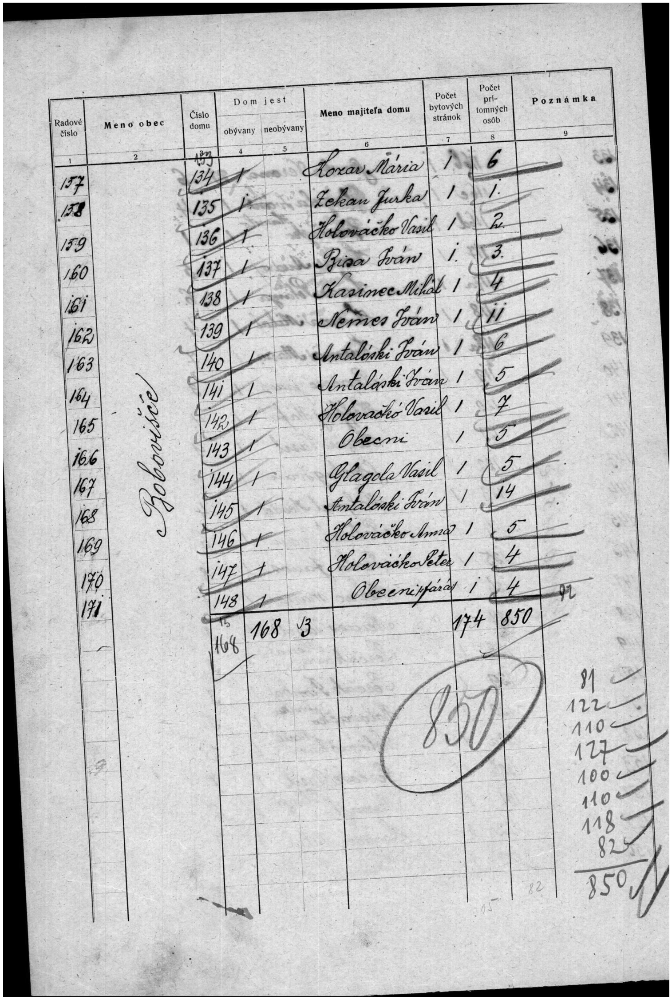

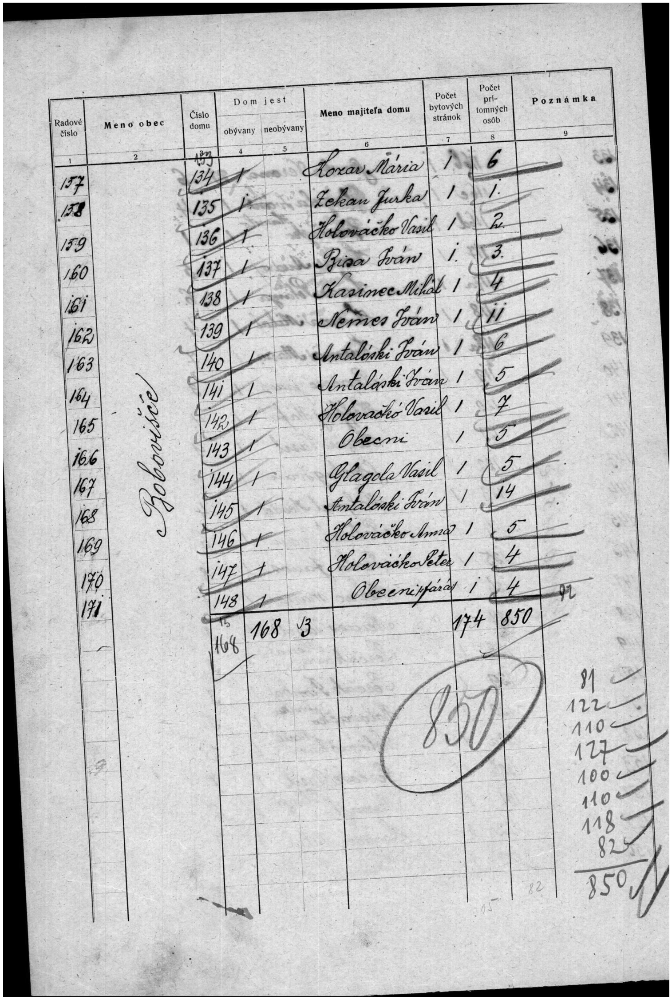

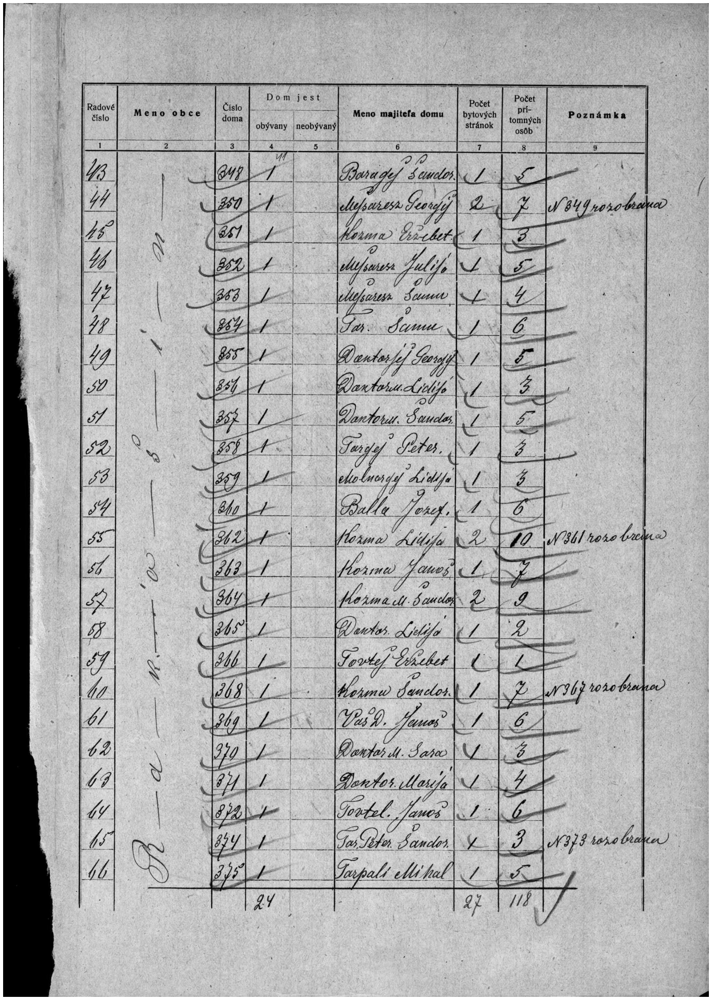

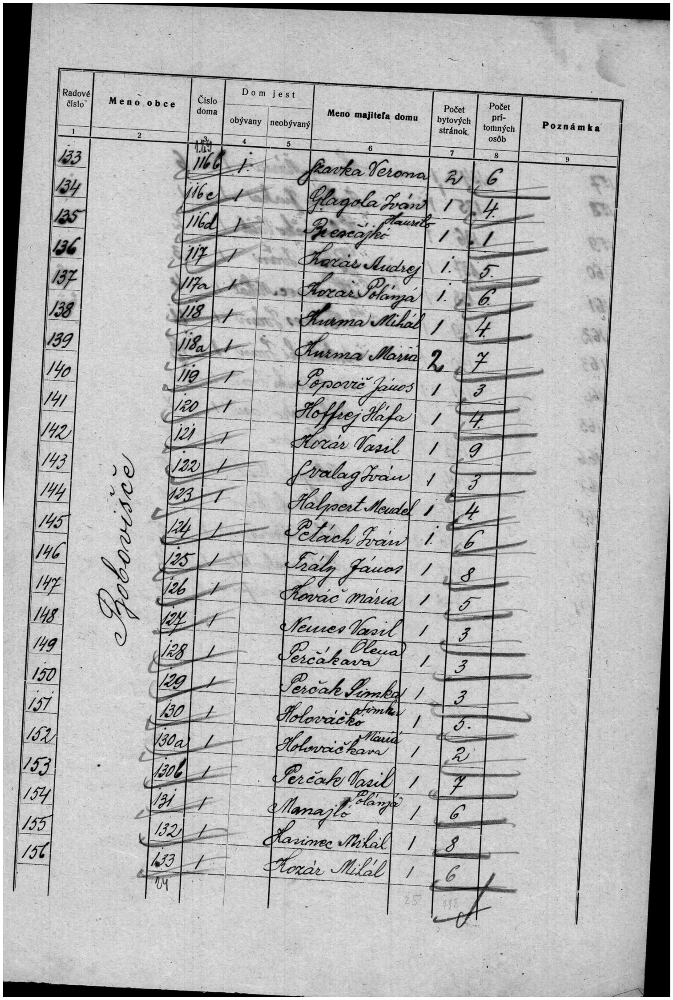

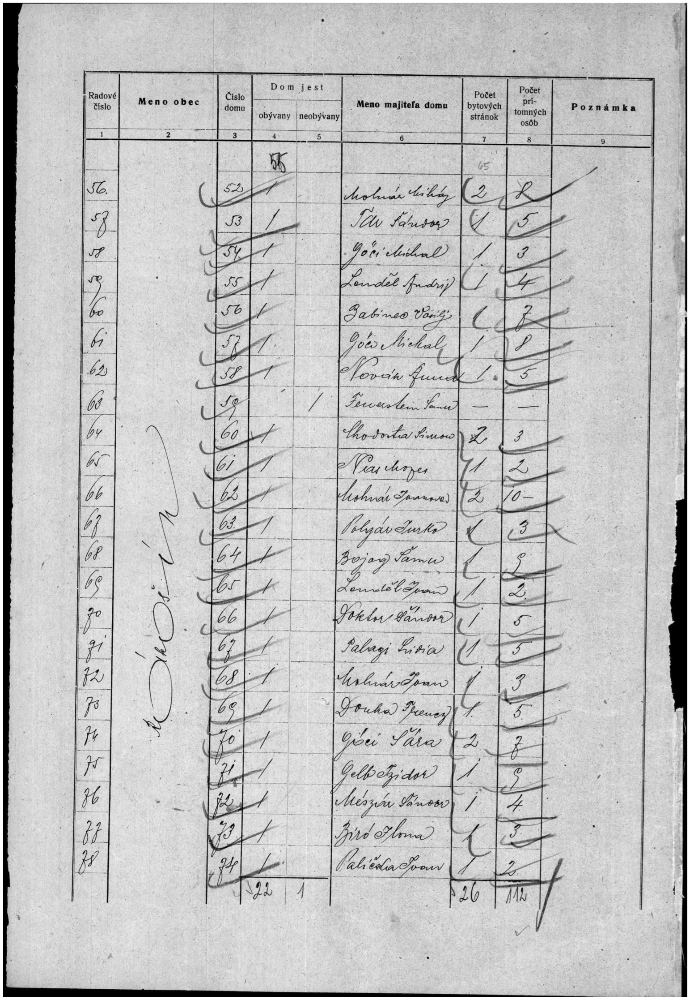

In [ ]:
def show_img(path):
    img = cv2.imread(path, cv2.IMREAD_GRAYSCALE)
    display_image_in_actual_size(img)
    

images_path = '../images/surname_tables/'
files = [os.path.join(images_path, p) for p in sorted(os.listdir(images_path))]
# getting 3 random images 
sample = random.sample(files, 3)

# batch_extractor(images_path)

ma = Matcher('features.pck')

for s in sample:
    print ('Query image ==========================================')
    show_img(s)
    names, match = ma.match(s, topn=3)
    print('Result images ========================================')
    for i in range(3):
        # we got cosine distance, less cosine distance between vectors
        # more they similar, thus we subtruct it from 1 to get match value
        print ('Match %s' % (1-match[i]))
        show_img(os.path.join(images_path, names[i]))